# DSFB Assignment 1

In this assignment, you will work with data, examine distributions of some variables, and make some simple predictions. These basic operations are important in any data science project. 

[Pandas](https://pandas.pydata.org/) is a Python package built for data analysis. It includes many useful functions, including one to read comma-separated (.csv) files. We will use this package as it's both easy to use and very powerful.

First, we need to import Pandas. As you will be learning (or already know), popular Python packages have common abbreviates. These abbreviations are used as a short-hand for that package throughout a Python script. Some of these common abbreviations include:

- `import pandas as pd`
- `import numpy as np`
- `import tensorflow as tf`
- etc.

Second, we can call any function in the Pandas package as `pd.someFunction`. The `pd` keyword is reserved for Pandas and must not be used by any other variable. 

Third, `import` statements are generally located at the top of a script, even though they might only be used at a later stage.

Finally, do not hesitate to search the [Pandas documentation](https://pandas.pydata.org/pandas-docs/stable/) for help.


In [1]:
import os

from math import log
 
import numpy as np    
import pandas as pd

import matplotlib.pyplot as plt

from sklearn.linear_model import LinearRegression
from sklearn.linear_model import LogisticRegression


import matplotlib
import matplotlib.pyplot as plt
%matplotlib inline

import seaborn as sns

from scipy.stats import lognorm
from scipy.stats import gamma
from scipy.stats import beta
from scipy.special import expit

# PART 1: WORK WITH A TAB-SEPARATED TEXT FILE

In this section, you will load in a plain text file where columns have been separated by a tab character. The tab character is represented in code as the: `\t` symbol.   

Tab separated data is typical for government data or legacy data coming out of old mainframe systems.  

We will us data from the US Patent Office (USPTO). The file contains two columns:

- id: patent sub-class id
- title: patent sub-class title

**PROBLEM**: Open and read in the `USPTOsubclasses.txt` file using the native Python `open()` command.

In [2]:
f=open("/Users/davidmaurissen/Documents/GitHub/2019-dsfb/assignments/data/USPTOsubclasses.txt","r")
content=f.read()
print(content)


id	title
-0T/74	NULL
01L/294.8	NULL
01L/298.8	NULL
01L/299.0	NULL
1/1	Unclassified
100/1	BINDING
100/10	With precutting of binder to length
100/10.*1	WITH ADDITIONAL TREATMENT OF MATERIAL (100/70 R)
100/100	WITH GROUND
100/100.**2	Heating, cooling, or drying (100/92)
100/101	WITH CLOTH ABOUT CAKE ENFOLDER
100/102	COMBINED
100/103	CONVERTIBLE
100/104	WITH DRAIN MEANS FOR EXPRESSED LIQUID
100/105	Plural liquids (peel oil)
100/106	Liquid impelling means
100/107	Drain tube inbedded in material
100/108	With piercing point or edge
100/109	Stacked boxes or plates
100/11	Plural flexible section binder
100/110	Drainage through or along pressure surface
100/111	With valve or adjustable flow regulator
100/112	With clearer or cleaner
100/113	Stacked boxes or plates
100/114	Flexibly connected
100/115	Boxes or plates
100/116	Movable surface
100/117	Helix
100/118	Endless conveyer
100/119	Trough forming
100/12	Through annular material
100/120	Material enclosing
100/121	Roll
100/122	Textile containing 

**PROBLEM**: Make a list of lists. First, split the data by line, and the split it again by column. 

In [3]:
# split the raw text by the new line character "\n" )
lines=content.split("\n")

print(lines)

['id\ttitle', '-0T/74\tNULL', '01L/294.8\tNULL', '01L/298.8\tNULL', '01L/299.0\tNULL', '1/1\tUnclassified', '100/1\tBINDING', '100/10\tWith precutting of binder to length', '100/10.*1\tWITH ADDITIONAL TREATMENT OF MATERIAL (100/70 R)', '100/100\tWITH GROUND', '100/100.**2\tHeating, cooling, or drying (100/92)', '100/101\tWITH CLOTH ABOUT CAKE ENFOLDER', '100/102\tCOMBINED', '100/103\tCONVERTIBLE', '100/104\tWITH DRAIN MEANS FOR EXPRESSED LIQUID', '100/105\tPlural liquids (peel oil)', '100/106\tLiquid impelling means', '100/107\tDrain tube inbedded in material', '100/108\tWith piercing point or edge', '100/109\tStacked boxes or plates', '100/11\tPlural flexible section binder', '100/110\tDrainage through or along pressure surface', '100/111\tWith valve or adjustable flow regulator', '100/112\tWith clearer or cleaner', '100/113\tStacked boxes or plates', '100/114\tFlexibly connected', '100/115\tBoxes or plates', '100/116\tMovable surface', '100/117\tHelix', '100/118\tEndless conveyer', '

In [4]:
# create a "list of lists" 
#   each entry in the "outer" list is a row from the file; 
#   each row can be split into an "inner" list of tab-separated columns

cols=[line.split("\t") for line in lines]
print(cols)

[['id', 'title'], ['-0T/74', 'NULL'], ['01L/294.8', 'NULL'], ['01L/298.8', 'NULL'], ['01L/299.0', 'NULL'], ['1/1', 'Unclassified'], ['100/1', 'BINDING'], ['100/10', 'With precutting of binder to length'], ['100/10.*1', 'WITH ADDITIONAL TREATMENT OF MATERIAL (100/70 R)'], ['100/100', 'WITH GROUND'], ['100/100.**2', 'Heating, cooling, or drying (100/92)'], ['100/101', 'WITH CLOTH ABOUT CAKE ENFOLDER'], ['100/102', 'COMBINED'], ['100/103', 'CONVERTIBLE'], ['100/104', 'WITH DRAIN MEANS FOR EXPRESSED LIQUID'], ['100/105', 'Plural liquids (peel oil)'], ['100/106', 'Liquid impelling means'], ['100/107', 'Drain tube inbedded in material'], ['100/108', 'With piercing point or edge'], ['100/109', 'Stacked boxes or plates'], ['100/11', 'Plural flexible section binder'], ['100/110', 'Drainage through or along pressure surface'], ['100/111', 'With valve or adjustable flow regulator'], ['100/112', 'With clearer or cleaner'], ['100/113', 'Stacked boxes or plates'], ['100/114', 'Flexibly connected'], 

In [5]:
# what's the sub-class "1/1" called?  hint: look at first 10 elements of your list...
for col in cols:
    if col[0]=='1/1':
        print("sub class '1/1' is", col[1])
        break

sub class '1/1' is Unclassified


**PROBLEM**: Turn the data into a Pandas dataframe and draw a random sample of 5 rows. 

In [6]:
# Hint: remember to split the header row from the data. It will be the first element in your list of lists
# move data into a Pandas dataframe for easier manipulation

df=pd.DataFrame(data=cols[1:], columns=cols[0])

In [7]:
# look at the dataframe
print(df.head())

          id         title
0     -0T/74          NULL
1  01L/294.8          NULL
2  01L/298.8          NULL
3  01L/299.0          NULL
4        1/1  Unclassified


# PART 2: WORK WITH A CSV FILE IN PANDAS

In this section, we load data from the `data/epfl.csv` file into a pandas dataframe.  

The CSV file contains the courses offered at EPFL with the following two columns: 

  - course: full course name
  - code: course code, including field of study


**PROBLEM**: Load the data from `data/epfl.csv` into a Pandas dataframe.

In [8]:
# load the CSV 
epfl_df=pd.read_csv('data/epfl.csv')



In [9]:
# look at the number of rows and columns (i.e., the shape)
print(epfl_df.shape)


(1758, 2)


**PROBLEM**: Look at the data.

In [10]:
# look at the first 5 rows
epfl_df.head()


,course,code
0,Accounting for finance,FIN-411
1,Advanced algorithms,CS-450
2,Advanced analog and rf integrated circuits des...,EE-520
3,Advanced analog and rf integrated circuits des...,EE-521
4,Advanced analysis i,MATH-400


In [11]:
# look at the last 5 rows
epfl_df.tail()

,course,code
1753,Water resources engineering,ENV-424
1754,Wave propagation along transmission lines,EE-575
1755,Wind energy,ETH-432
1756,Wireless receivers: algorithms and architectures,EE-442
1757,"Wood structures, properties and uses",MSE-466


In [12]:
# look at a random sample of 5 rows

epfl_df.sample(n=5)

,course,code
1440,Sèminaire d'intègration,HEP-450
562,Figuration et reprèsentation de l'architecture,AR-210
951,Microcontrùleurs et conception de systëmes num...,EE-208
1672,Theory of computation,CS-251
1545,Statistical population genetics,BIO-451


## Create a new column: " `field` " 

The next set of problems are intended to extract the field code (e.g.: CS, EE, MATH) from the course code column and put it in a new column called `field`.

**PROBLEM**: Create a new column called `field` and fill it with zeros.

In [13]:
# create a dummy column called 'field' filled with a marker to indicate the value is currently missing
#   hint: the numpy package defines a special value called NaN to indicate Not a Number... 
#         so set the new column to `np.nan`

epfl_df['field']=np.nan
epfl_df.head()

,course,code,field
0,Accounting for finance,FIN-411,NaN
1,Advanced algorithms,CS-450,NaN
2,Advanced analog and rf integrated circuits des...,EE-520,NaN
3,Advanced analog and rf integrated circuits des...,EE-521,NaN
4,Advanced analysis i,MATH-400,NaN


**PROBLEM**: Fill the new column with the field of the course. What symbol do you split on?

In [14]:
# fill the 'field' column with the split code
nan_idx = epfl_df['code'].isna()
epfl_df['field'][~nan_idx] = epfl_df['code'][~nan_idx].apply(lambda x: x.split('-'))
epfl_df['field'].head()

//anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  This is separate from the ipykernel package so we can avoid doing imports until


0     [FIN, 411]
1      [CS, 450]
2      [EE, 520]
3      [EE, 521]
4    [MATH, 400]
Name: field, dtype: object

In [15]:
# select the first list element (index 0) for each field entry
epfl_df['field'][~nan_idx] = epfl_df['field'][~nan_idx].apply(lambda x : x[0])
epfl_df.head()

,course,code,field
0,Accounting for finance,FIN-411,FIN
1,Advanced algorithms,CS-450,CS
2,Advanced analog and rf integrated circuits des...,EE-520,EE
3,Advanced analog and rf integrated circuits des...,EE-521,EE
4,Advanced analysis i,MATH-400,MATH


## Now clean the dataset, find missing fields, and remove those entries.

**PROBLEM**: Look at some examples where a value for `field` is missing. What's a course without a code/field?

In [16]:
# look at the entries without a field
epfl_nan=epfl_df[epfl_df['code'].isna()]
epfl_nan.head()

,course,code,field
161,Autre contribution ‡ l'enseignement,NaN,NaN
162,Autre contribution ‡ l'enseignement,NaN,NaN
244,Chimie gènèrale avancèe (‡ choix),NaN,NaN
334,Cours ethz,NaN,NaN
335,Cours ethz,NaN,NaN


**PROBLEM**: How many rows are removed by dropping all rows without a value for `field`?

In [17]:
# inspect the shape of data before removing missing values
epfl_nan.shape

(81, 3)

In [18]:
# remove entries without a description
epfl_dropnan=epfl_df.dropna(subset=['field'])


In [19]:
# after removing entries, inspect the shape of data again
epfl_dropnan.shape



(1677, 3)

In [20]:
# make sure that entries were indeed removed
epfl_dropnan.isna().any()


course    False
code      False
field     False
dtype: bool

In [21]:
epfl_df.field.unique()

array(['FIN', 'CS', 'EE', 'MATH', 'BIOENG', 'CIVIL', 'ME', 'COM', 'ChE',
       'MICRO', 'CH', 'MSE', 'ENV', 'ETH', 'HUM', 'PREPA', 'HEP', 'MGT',
       'AR', 'PENS', 'PHYS', nan, 'BIO', 'ENG', 'DH', 'EPFL'],
      dtype=object)

## Now find out how many courses EPFL offers in each field. 

**PROBLEM**: Count the number of course entries by field  

In [22]:
# Count the number of course entries. Hint: Use Pandas `.groupby()` function to aggregate by field
epfl_ct=epfl_dropnan.groupby('field').course.count()
epfl_ct.head()




field
AR        130
BIO        76
BIOENG     29
CH         88
CIVIL      85
Name: course, dtype: int64

**PROBLEM**: How many Architecture (AR) courses are offered at EPFL?  

In [23]:
# You could just manually look at the results from above, or....
#   hint: the .loc['AR'] access method of a dataframe will find all results for 'AR' (of which there is one )
#         or the .at['AR','course'] access method will find the result for 'AR' for the aggregated value in 'course'

print('The number of AR courses is',epfl_ct.loc['AR'])
#or .=['']



The number of AR courses is 130


**PROBLEM**: What field has the most courses?

In [24]:
# Hint: sort the grouped_bydata in descending order to find out what the most common fields are

epfl_ct_st=epfl_ct.sort_values(ascending=False)
print('The field with the most courses is', epfl_ct_st.index[0],'and has', epfl_ct_st[0],'courses')


The field with the most courses is HUM and has 178 courses


### Finally, write the results back to disk

In this part, write the number of courses per field to disk as an Excel file and as a comma separated (.csv) file.

In [25]:
# First, we will re-organize the Pandas dataframe such that it has just two columns: field, course_count
#   The following code calls .reset_index() to reset the indexing of the dataframe
#   The code also redefines the names of the columns by setting .columns = ['field', 'course_count']

EPFLcourses_count = epfl_ct.reset_index()
EPFLcourses_count.columns = ['field', 'course_count']
EPFLcourses_count.head()

# NOTE -- the code above is given to you because it is very tricky. 
# But adapt it based on the names you have used for your own dataframe

,field,course_count
0,AR,130
1,BIO,76
2,BIOENG,29
3,CH,88
4,CIVIL,85


**PROBLEM**: Write the data to BOTH an .xlsx and .csv file.

In [26]:
# write data to .xlsx (be sure to drop the index column)
EPFLcourses_count.to_excel('EPFLcourses_count.xlsx',index=False)



In [27]:
# write data to .csv (be sure to drop the index column)
EPFLcourses_count.to_csv('EPFLcourses_count.csv',index=False)



# PART 3: A SIMPLE REGRESSION PROBLEM

### First, let's define a simple DGP for this section...

We will define the DGP as a simple line, of the form `y = m * x + b` with the following coefficients: `m = 2` and `b = 3``

In [28]:
# this function implements our DGP

def dgp(x):
    return 2 * x + 3

**PROBLEM**: Does the DGP have any variance or noise?

It is a deterministic function so it does not have any noise nor variance.



**PROBLEM**: What are the values of `y` when `x` is equal to 1, 2, 3, 4 and 5?

In [29]:
# toy data
x = range(1, 6)
y = [dgp(i) for i in x]
print(y)




[5, 7, 9, 11, 13]


**PROBLEM**: Plot our data as red dots, and then _overlay_ a plot of the DGP as a black line 

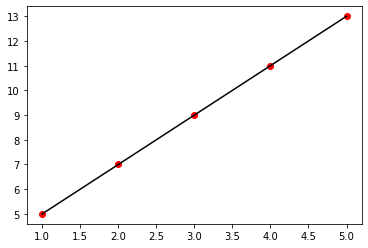

In [30]:
# plot data with axis labels
plt.plot(x, y, 'ro', x, y, 'black');

### Use the sample mean to make a _very_ simple prediction...

The most basic "model" is just to predict the mean of Y. 

**PROBLEM**: Calculate and report the mean of the outcome variable `y`?

In [31]:
# compute the mean manually

ymean=sum(y)/len(y)
ymean


9.0

In [32]:
# now use a function from the numpy package to calculate the mean

np.mean(y)



9.0

**PROBLEM**: Plot our data as red dots, _overlay_ a plot of the DGP as a black line, and overlay a horizontal line at the mean of Y 

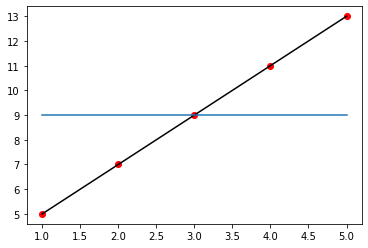

In [33]:
# plot mean prediction

plt.plot(x, y, 'ro', x, y, 'black',x, [ymean]*len(x));



**PROBLEM**: How well does the mean fit our DGP?

not at all :'(


### Fit a simple linear regression

You will now try to estimate the coefficients for the `m` and `b` parameters you see in the DGP.  

**PROBLEM**: Prepare to do a linear regression to `X` and `y`.

Let's convert all data into arrays (as defined by the numpy package) so that we know it is valid for numerical computation.

In [34]:
# First, you need to reshape the X data into a "Design Matrix" (a two-dimensional shape)
#  use the reshape() method of the array class of the numpy package
#  your desing matrix with have multiple rows of observations, 
#     but only 1 column as there is one predictor
X = np.array(x).reshape(len(x), 1)
X



array([[1],
       [2],
       [3],
       [4],
       [5]])

In [35]:
# Second, also covert your y data into a numpy array 
#   hint: no need to change the shape - a simple 1-dimensional array (the default) is fine
y = np.array(y)
y


array([ 5,  7,  9, 11, 13])

**PROBLEM**: Fit a linear regression for `y` and `X`

In [36]:
# fit a linear regression using the LinearRegression() model from sklearn
reg = LinearRegression().fit(X,y)



**PROBLEM**: Find and report the r-squared, coefficient m, and intercept for the model.

In [37]:
# evaluate the fit in terms of R^2 (i.e. variance explained)
r2=reg.score(X, y)
r2


1.0

In [38]:
# estimate coefficient m

m=reg.coef_[0]
m


2.0000000000000004

In [39]:
# estimate intercept b
b=reg.intercept_ 
b



2.9999999999999982

**PROBLEM**: Use the fitted regression model to calculate the predicted value of `y` at `x = 6`.

In [40]:
# use fitted model to predict y at x = 6

y_predict=reg.predict(np.array([[6]]))
y_predict[0]

15.000000000000002

**PROBLEM**: Show (by manual calculation) that the predicted value above matches the true DGP.

dgp(6)=15
ypredict=15.000000000000002    

# PART 4: A SIMPLE CLASSIFICATION PROBLEM

We will now consider some data that will be generated by a *nonlinear* and *noisy* DGP. We want to predict two classes, where `y` equals `1` or `0`, that depend only on the value of `x`. 

Think back to the Credit Default demo. In this example, `y` stands for defaulting and `x` might stand for your amount of debt. For this simple scenario, the more debt you have, the more likely you are to default. We would like predictions to lie in the continuous inerval `[0,1]`.

In [41]:
# generate random samples with seed = 0 and look at the first 10 values of X

np.random.seed(0)
n_samples = 100

X = np.random.normal(size = n_samples)
X[:10]  # inspect the first 10 observations

array([ 1.76405235,  0.40015721,  0.97873798,  2.2408932 ,  1.86755799,
       -0.97727788,  0.95008842, -0.15135721, -0.10321885,  0.4105985 ])

For all values `X > 0`, we will set `y` equal to `1` and `0` otherwise. Add some random noise to `X`. 

In [42]:
# set y to 1 if X > 0

y = X > 0               # Hint: this creates a y array of True and False
y = y.astype(np.float)  # Hint: this converts booleans to 1.0 if try, and 0.0 if False
y[:10]                  # look at the first 10 entries of y

array([1., 1., 1., 1., 1., 0., 1., 0., 0., 1.])

In [43]:
# add some Gaussian noise around the transition point of x = 0 

X = X + 0.2 * np.random.normal(size = n_samples)
X[:10]   # inspect first 10 entries of X

array([ 2.14068249,  0.1306054 ,  0.72464098,  2.43477254,  1.63293331,
       -0.58855364,  0.86736462, -0.30084817,  0.28136955,  0.70670146])

### Plot the data

Simply plot the data - plotting the data is key before fitting any statistical model. 

**PROBLEM**: Plot `X` and `y` on a scatterplot. Will a linear classifier fit these data well?

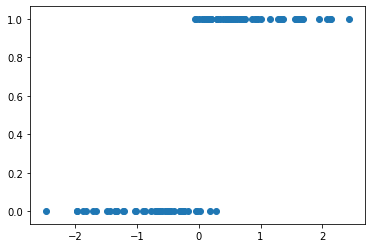

In [44]:
# scatterplot with axis labels

plt.scatter(X,y)




### Fit a linear probability model

In this part, we simply plot the data. Plotting the data is key before fitting any statistical model. 

**PROBLEM**: Fit a linear regression and look at the intercept. Does the intercept have a reasonable values? Why not?

In [45]:
# fit the linear regression (hint: call .reshape(-1, 1) on X to tell NumPy that there's only one predictor )
X = X.reshape(-1,1)
reg=LinearRegression().fit(X,y)
reg.intercept_


0.5216114089967183

Indeed the intercept have a reasonable value because it is the mean of [0,1]

**PROBLEM**: Plot the linear regression fit.

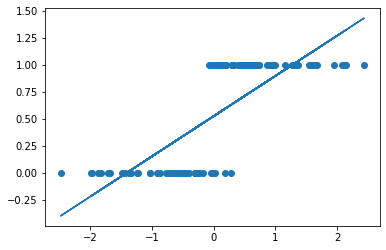

In [46]:
# plot linear regression fit
m=reg.coef_[0]
b=reg.intercept_

plt.scatter(X, y)
plt.plot(X, m*X+b);

**PROBLEM**: What can you say about predictions for very small/large `x`?

for very small/large x we have a very bad prediction because the data is not linear.


### Now fit a sigmoidal logit model, which may better fit the data.

Remember that for historical reasons, this is called "logistic regression" -- but it is for classification, not regression.

**PROBLEM**: Fit a logit model. 

In [47]:
# fit the logistic regression
clf = LogisticRegression(random_state=0, solver='lbfgs', multi_class='multinomial').fit(X, y)


**PROBLEM**: Plot the fitted function. Hint: apply the expit() function to your prediction. This will convert the predictions to an inverse sigmoid shape. How does this model fit the data?

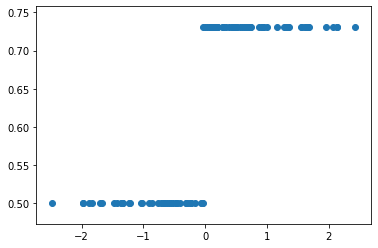

In [48]:
# plot linear regression fit
y_predict=clf.predict(X)
plt.scatter(X, expit(y_predict));

the model does not fit the data and I don not know why :'(

# Part 5: Examine Empirical Distributions 

In this section we have already drawn three samples from three different distributions. These appear in the `data/` directory as the files: `data1.txt`, `data2.txt`, `data3.txt`  

You do not know the true distributions from which these samples were drawn - but you can investigate them and try to guess...

### Helper Functions

**PROBLEM**: Define a function to load a list of numbers from a text file.

In [49]:
def load(file_path):
    return np.loadtxt('data/'+file_path)


**PROBLEM**: Define a function to plot a histogram for some data.  

In [50]:
def histogram(data):
    plt.hist(data, bins=50, density=True)


### Distribution 1

**PROBLEM**: Using your functions above, plot a histogram of `data1.txt`

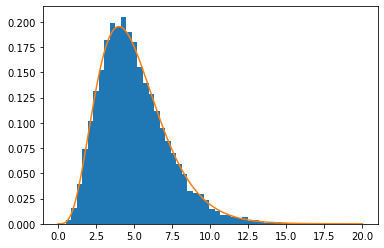

In [51]:
data1 = load('data1.txt')
histogram(data1)
x1 = np.linspace(0, 20, 20000)
plt.plot(x1, gamma(5).pdf(x1));


**PROBLEM**: Using your functions above, plot a histogram of the logged values of `data1.txt`

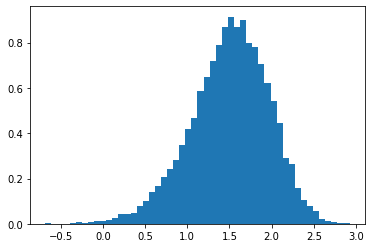

In [52]:
histogram(np.log(data1))



### Distribution 2

**PROBLEM**: Using your functions above, plot a histogram of `data2.txt`

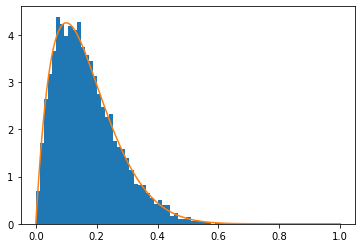

In [53]:
data2 = load('data2.txt')
histogram(data2)
x2 = np.linspace(0, 1, 1000)
plt.plot(x2, beta(2, 10).pdf(x2))


**PROBLEM**: Using your functions above, plot a histogram of the logged values of `data2.txt`

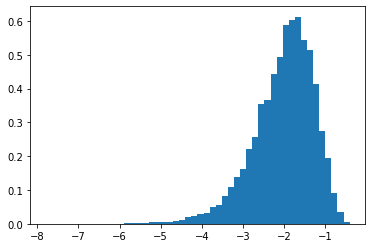

In [54]:
histogram(np.log(data2))


### Distribution 3

**PROBLEM**: Using your functions above, plot a histogram of `data3.txt`

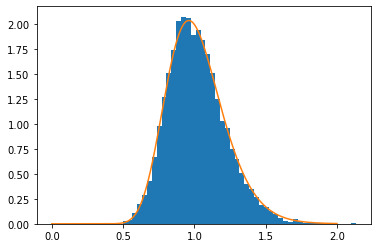

In [55]:
data3 = load('data3.txt')
x3 = np.linspace(0, 2, 2000)
histogram(data3)
plt.plot(x3, lognorm(0.2).pdf(x3))


**PROBLEM**: Using your functions above, plot a histogram of the logged values of `data3.txt`

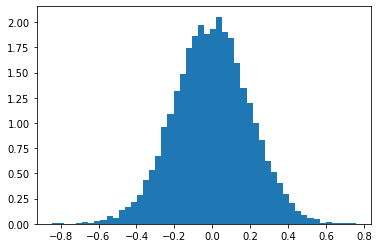

In [56]:
histogram(np.log(data3))


### Make educated guesses about the distributions

Do some self-directed research to learn about different types of continuous distributions (guassian, gamma, exponential, etc.). Can you identify a distribution that you think could generated each of the three data files you observe above? If so, what kind of distributions? Explain each one for each file.

**PROBLEM**: What might be the distribution of `data1.txt`?

It seems to be a gamma distribution because the x-axis is not between [0,1] and it s realy look like a gamma distribution

**PROBLEM**: What might be the distribution of `data2.txt`?

It seems to be a beta distribution, it has the same shape and the support is [0,1]


**PROBLEM**: What might be the distribution of `data3.txt`?

The logged values look like a normal distribution, so it should be a log-normal distribution

### Estimate parameters for the distributions

**PROBLEM**: Based on your guess as to the true distribution of the distribution for the `data1.txt` sample, estimate parameters for that distribution.

The gamma distribution has 2 parameters: k and $\theta$ 
To compute them, we use the fact that the mean m is given by $k\theta$ and the variance v is given by $k\theta$
so $\theta$ = v / m and k = m / $\theta$


In [57]:
m = np.mean(data1)
v = np.var(data1)
theta = v / m
k = m /theta
print('k =',  k, 'and theta =', theta)

k = 5.059201310276107 and theta = 0.983531318882683


**PROBLEM**: Based on your guess as to the true distribution of the distribution for the `data2.txt` sample, estimate parameters for that distribution.

The beta distribution has 2 parameters: $\alpha$ and $\beta$ where :  
$\alpha=m\left(\frac{m(1-m)}{v}-1\right)$ and $\beta=(1-m)\left(\frac{m(1-m)}{v}-1\right)$


In [58]:
m = np.mean(data2)
v = np.var(data2)
a=m*(m*(1-m)/v-1)
b=(1-m)*(m*(1-m)/v-1)
print('alpha =',  a, 'and beta =', b)

alpha = 2.0270041691258016 and beta = 10.080312129397464


**PROBLEM**: Based on your guess as to the true distribution of the distribution for the `data3.txt` sample, estimate parameters for that distribution.

X=exp(Z) where Z follows N(m, v) so X follows logN(mlog, vlog)

In [59]:
m = np.mean(np.log(data3))
v = np.var(np.log(data3))
print('mlog =',  np.exp(m+v/2), 'and vlog =', (np.exp(v)-1)*np.exp(2*m+v))

mlog = 1.0162863676235179 and vlog = 0.041463141228317346


### Comment on your estimated parameters for the above distributions

**PROBLEM**: Will the estimated parameters reported in Question 6 above be the **_True_** population parameters? Why or why not?

yes it is, justification in the previous graph



# Part 6: Plot some Theoretical Distributions 

In the previous section, you examined empirical distributions for three files. Now you will plot the theoretical probability density function (pdf) from one particular distribution: the Beta distribution.   

The Beta distribution has two parameters: $\alpha$ and $\beta$).


**PROBLEM**: Plot the **pdf** for a beta distribution with parameters $\alpha = 2$ and $\beta = 5$.

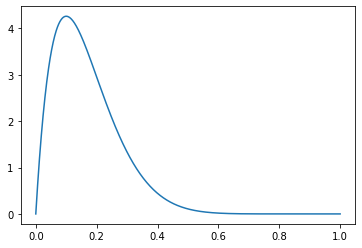

In [60]:
x = np.linspace(0, 1, 1000)
plt.plot(x, beta(2, 10).pdf(x))


**PROBLEM**: Now plot the same pdf with vertical lines and labels for the lines at the mean, median, and mode of the same distribution as above.

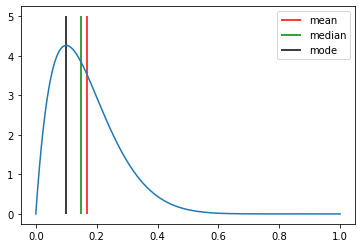

In [61]:
dist = beta(2, 10)
plt.plot(x, dist.pdf(x));


# plot mean
plt.vlines(dist.mean(), 0, 5, label='mean', color='r');


# plot median
plt.vlines(dist.median(), 0, 5, label='median', color='g');


# plot mode
plt.vlines(dist.pdf(x).argmax()/len(x), 0, 5, label='mode');

plt.legend();

**PROBLEM**: Comment on why (intuitively) the mean, median and mode are ordered as shown above. 

the mode is centered and the peak of the distribution because the mode is the most likely value of the distribution
the median follow because the area bellow the curve at right is far superior than the left area
the mean ends because the area bellow the curve at the left of the median is smaller than the right area



**PROBLEM**: Comment on the nature of the probability distribution function for the outcome. What's the distribution skew and kurtosis? How can we interpret skewness? Why does skewness matter? What migh be a remedy to "de-skew" data?

In [62]:
# compute skewness and kurtosis to use in your answer
mean, var, skew, kurt = beta.stats(2, 10, moments='mvsk')
print('skewness =',  skew, 'and kurtosis =', kurt)

skewness = 0.9214008855198343 and kurtosis = 0.7885714285714286


The skewness quantify the asymmetry of the distribution, if it is centerd then skew is 0. To de-skew data we would like to have the first and the second argument to be equals.

